# 尝试柏市的OpenStreetMap的数据

## 第一步从OSM的数据库中获取一下柏市的数据试试看

In [12]:
import osmnx as ox

place_name = "Kashiwa, Chiba, Japan"
kashiwa_polygon = ox.geocode_to_gdf(place_name)

# 顺便计算一下城市的中心点，用于将来绘制的时候使用
centroid = kashiwa_polygon.geometry.centroid.iloc[0]

# 从中心点里取出纬度和经度
center_lat = centroid.y
center_lon = centroid.x

kashiwa_polygon

C:\Users\laval\AppData\Local\Temp\ipykernel_12056\1449925056.py:7: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroid = kashiwa_polygon.geometry.centroid.iloc[0]


,geometry,bbox_west,bbox_south,bbox_east,bbox_north,place_id,osm_type,osm_id,lat,lon,class,type,place_rank,importance,addresstype,name,display_name
0,"POLYGON ((139.91332 35.89814, 139.91339 35.897...",139.913323,35.781216,140.111938,35.935847,244125591,relation,2679925,35.867622,139.975688,boundary,administrative,14,0.558394,city,Kashiwa,"Kashiwa, Chiba Prefecture, Japan"


这里就能看到已经获取了一个数据，但是应该GeoDataFrame的逻辑

我们再尝试获取一下道路信息和公园信息作为例子

In [8]:
# 1. 获取柏市的“行车道路网络” (drive 表示允许机动车的道路)
Road = ox.graph_from_place(place_name, network_type="drive")

# 2. 把图结构(Graph)转成 GeoDataFrame
nodes, edges = ox.graph_to_gdfs(Road)

# 定义我们关心的公园类 leisure tag
park_tags = {
    "leisure": ["park", "recreation_ground", "pitch", "playground"]
}

parks = ox.features_from_place(place_name, tags=park_tags)

然后数据成功之后，我们就能够使用Python的标准绘制库将这些gdf绘制出来

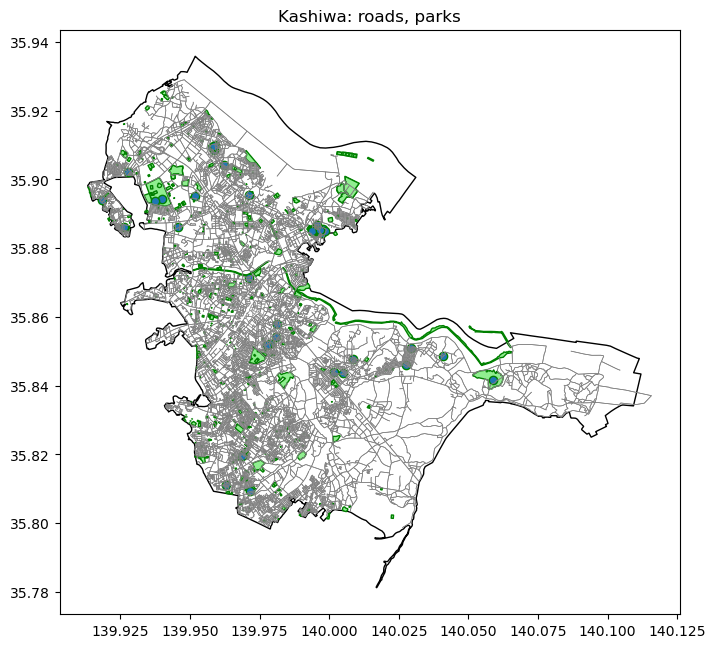

In [10]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(8, 8))

# 画柏市边界
kashiwa_polygon.plot(ax=ax, edgecolor="black", facecolor="none")

# 画道路（灰色）
edges.plot(ax=ax, linewidth=0.5, color="gray")

# 画公园（绿色）
if not parks.empty:
    parks.plot(ax=ax, edgecolor="green", facecolor="lightgreen")

ax.set_title("Kashiwa: roads, parks")
plt.show()

## 第二步 我们可以使用leaflet将这些数据绘制在一张可以交互的地图上

In [14]:
import folium

# 如果之前已经有 center_lat / center_lon，可以直接用
m = folium.Map(
    location=[center_lat, center_lon],
    zoom_start=12,
    tiles="OpenStreetMap"
)


folium.GeoJson(
    kashiwa_polygon,
    name="Kashiwa boundary",
    style_function=lambda feat: {
        "color": "black",
        "weight": 2,
        "fill": False
    }
).add_to(m)

folium.GeoJson(
    edges,
    name="Roads",
    style_function=lambda feat: {
        "color": "gray",
        "weight": 1
    }
).add_to(m)

if not parks.empty:
    folium.GeoJson(
        parks,
        name="Parks",
        style_function=lambda feat: {
            "color": "green",
            "weight": 1,
            "fillColor": "lightgreen",
            "fillOpacity": 0.5
        }
    ).add_to(m)

folium.LayerControl().add_to(m)

# 最后显示地图
m